<div class="width: 100%; position:relative;">
    <img style="float: left; padding-right: 10px; width: 200px" src="https://fligoo.com/img/logo-large.png">
    <div style="float: right; font-size: 32px; padding-top: 30px;">
        <b>Take Home - Data Science</b>
    </div>
</div>


# The Hotel Bookings Data
Let’s use hotel bookings data from [Antonio, Almeida, and Nunes (2019)](https://www.sciencedirect.com/science/article/pii/S2352340918315191?via%3Dihub) to predict which hotel stays included children and/or babies, based on the other characteristics of the stays such as which hotel the guests stay at, how much they pay, etc.

<img src="https://s3-us-west-2.amazonaws.com/fligoo.data-science/TechInterviews/HotelBookings/header.png"/>

One of the hotels (H1) is a resort hotel and the other is a city hotel (H2). Both datasets share the same structure, with 23 variables describing the 19248 observations of H1 and 30752 observations of H2. Each observation represents a hotel booking. Both datasets comprehend bookings due to arrive between the 1st of July of 2015 and the 31st of August 2017, including bookings that effectively arrived and bookings that were canceled. Since this is hotel real data, all data elements pertaining hotel or costumer identification were deleted.

**Take-Home Goals**
- During **Part I** you should perform an Exploratory Data Analisys highlighting key findings:
  - Data Quality Check: You must check the quality of the given dataset to make an assessment of how appropriate it is for later Data Science tasks. Propose a set of corrective actions over the data if any.
  - Report insights and conclusions: Describe the results obtained during the exploratory analysis and provide conclusions from a business perspective, supported by charts / tables / metrics.
- On **Part II** you should define and train a model to predict which actual hotel stays included children/babies, and which did not:
  - Feature extraction: Indicate some possible candidates of features that could properly describe the hotels, either from the given columns or from their transformations.
  - Machine Learning modeling: at least one fitted model with the given data. You could use the `children` column as target.
- Finally, on **Part III** you should present the key findings, conclusions and results to non-technical stakeholders.
  
**Requirements**
- Python 3.x & Pandas 1.x or R & Tidyverse & Tidymodels
- Paying attention to the details and narrative is far way more important than extensive development.
- Once you complete the assessment, please send a ZIP file of the folder with all the resources used in this work (e.g. Jupyter notebook, Python scripts, text files, images, etc) or share the repository link.
- Have a final meeting with the team to discuss the work done in this notebook and answer the questions that could arise.
- Finally, but most important: Have fun!

**Nice to have aspects**
- Dockerfile to setup environment / Conda environment for isolation.
- Code versioning with Git (you are free to publish it on your own Github/Bitbucket account!).
- Show proficiency in Python: By showing good practices in the structure and documentation, usage of several programming paradigms (e.g. imperative, OOP, functional), etc.


## Part I - Exploratory Data Analisys

In [99]:
# Data Processing and Handling
import pandas as pd
import numpy as np
import os
import joblib
from sklearn.preprocessing import LabelEncoder, OneHotEncoder, StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

# Model Training and Evaluation (Regression)
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.svm import SVR
from sklearn.ensemble import RandomForestRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.ensemble import GradientBoostingRegressor
import lightgbm as lgb

# Model Training and Evaluation (Classification)
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import RandomizedSearchCV
from sklearn.model_selection import KFold, cross_val_score
from scipy.stats import randint

# Visualization and Exploration
import matplotlib.pyplot as plt
import seaborn as sns

# Additional Libraries and Configurations
from datetime import datetime
import shap
from scipy import stats


In [49]:
#RAW Data
hotels = pd.read_csv('https://s3-us-west-2.amazonaws.com/fligoo.data-science/TechInterviews/HotelBookings/hotels.csv')
df=hotels

## Part I - EDA

Exploratory Data Analysis


<span style="font-size:20px; font-weight:bold;">Raw Data Analysis
</span>


In [50]:
#HEAD SAMPLE
df.head(3)

,hotel,lead_time,stays_in_weekend_nights,stays_in_week_nights,adults,children,meal,country,market_segment,distribution_channel,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,reserved_room_type,assigned_room_type,booking_changes,deposit_type,days_in_waiting_list,customer_type,average_daily_rate,required_car_parking_spaces,total_of_special_requests,arrival_date
0,City_Hotel,217,1,3,2,none,BB,DEU,Offline_TA/TO,TA/TO,0,0,0,A,A,0,No_Deposit,0,Transient-Party,80.75,none,1,2016-09-01
1,City_Hotel,2,0,1,2,none,BB,PRT,Direct,Direct,0,0,0,D,K,0,No_Deposit,0,Transient,170.00,none,3,2017-08-25
2,Resort_Hotel,95,2,5,2,none,BB,GBR,Online_TA,TA/TO,0,0,0,A,A,2,No_Deposit,0,Transient,8.00,none,2,2016-11-19


In [51]:

#Columns & Rows
print("Our dataset have ", df.shape[1] ,' columns.')
print("Our dataset have ", df.shape[0] ,' rows.')
df.info()

Our dataset have  23  columns.
Our dataset have  50000  rows.
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50000 entries, 0 to 49999
Data columns (total 23 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   hotel                           50000 non-null  object 
 1   lead_time                       50000 non-null  int64  
 2   stays_in_weekend_nights         50000 non-null  int64  
 3   stays_in_week_nights            50000 non-null  int64  
 4   adults                          50000 non-null  int64  
 5   children                        50000 non-null  object 
 6   meal                            50000 non-null  object 
 7   country                         49711 non-null  object 
 8   market_segment                  50000 non-null  object 
 9   distribution_channel            50000 non-null  object 
 10  is_repeated_guest               50000 non-null  int64  
 11  previous_cancellations         

In [87]:
#Column Variables
for col in df.describe(include = 'object').columns:
    print(col)
    print(df[col].unique())
    print('-'*70)

hotel
['City_Hotel' 'Resort_Hotel']
----------------------------------------------------------------------
children
['none' 'children']
----------------------------------------------------------------------
meal
['BB' 'HB' 'SC' 'Undefined' 'FB']
----------------------------------------------------------------------
country
['DEU' 'PRT' 'GBR' 'ROU' 'ESP' 'FRA' 'NLD' 'Unknown' 'CN' 'ITA' 'BEL'
 'HRV' 'IRL' 'NOR' 'AUT' 'FIN' 'ISR' 'USA' 'RUS' 'AGO' 'CHL' 'SWE' 'POL'
 'CHE' 'COL' 'BRA' 'CHN' 'HUN' 'KOR' 'NZL' 'DNK' 'MEX' 'AUS' 'CZE' 'LTU'
 'GRC' 'TUR' 'LVA' 'LCA' 'ARG' 'DMA' 'LUX' 'LBN' 'VEN' 'CIV' 'MLI' 'JPN'
 'OMN' 'THA' 'SRB' 'SVK' 'IDN' 'IND' 'GNB' 'UKR' 'EST' 'SVN' 'CAF' 'DZA'
 'KNA' 'MOZ' 'URY' 'CYP' 'VNM' 'IRN' 'ALB' 'ARE' 'BLR' 'MAR' 'PHL' 'ECU'
 'MLT' 'CUB' 'BGR' 'EGY' 'SAU' 'BOL' 'TUN' 'NPL' 'PER' 'ISL' 'KAZ' 'ASM'
 'TWN' 'CMR' 'MAC' 'KWT' 'NGA' 'SUR' 'SGP' 'PRI' 'TGO' 'BIH' 'TZA' 'KEN'
 'ZAF' 'BWA' 'AZE' 'FRO' 'MYS' 'CPV' 'CRI' 'STP' 'MUS' 'PAK' 'LKA' 'UZB'
 'BRB' 'ARM' 'IRQ' 'D

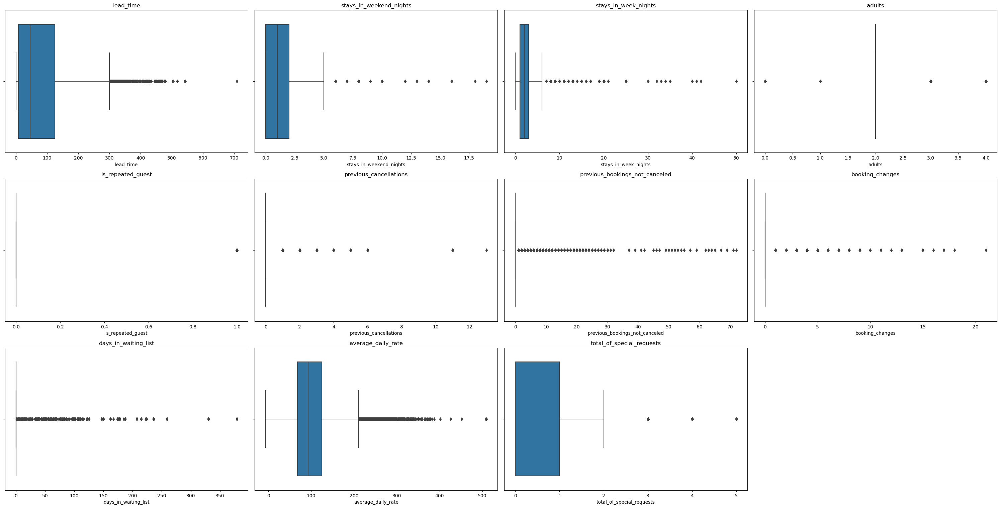

In [53]:
#Box Plot for Numeric Columns
# Exclude non-numeric columns
numeric_cols = df.select_dtypes(include=np.number).columns.tolist()

num_rows = 6
num_cols = 4  # Adjust this according to how many plots you want per row
fig, axes = plt.subplots(nrows=num_rows, ncols=num_cols, figsize=(30, 30))
axes = axes.flatten()

for i, feature in enumerate(numeric_cols):
    sns.boxplot(x=df[feature], ax=axes[i])
    axes[i].set_title(feature)

for j in range(i + 1, num_rows * num_cols):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

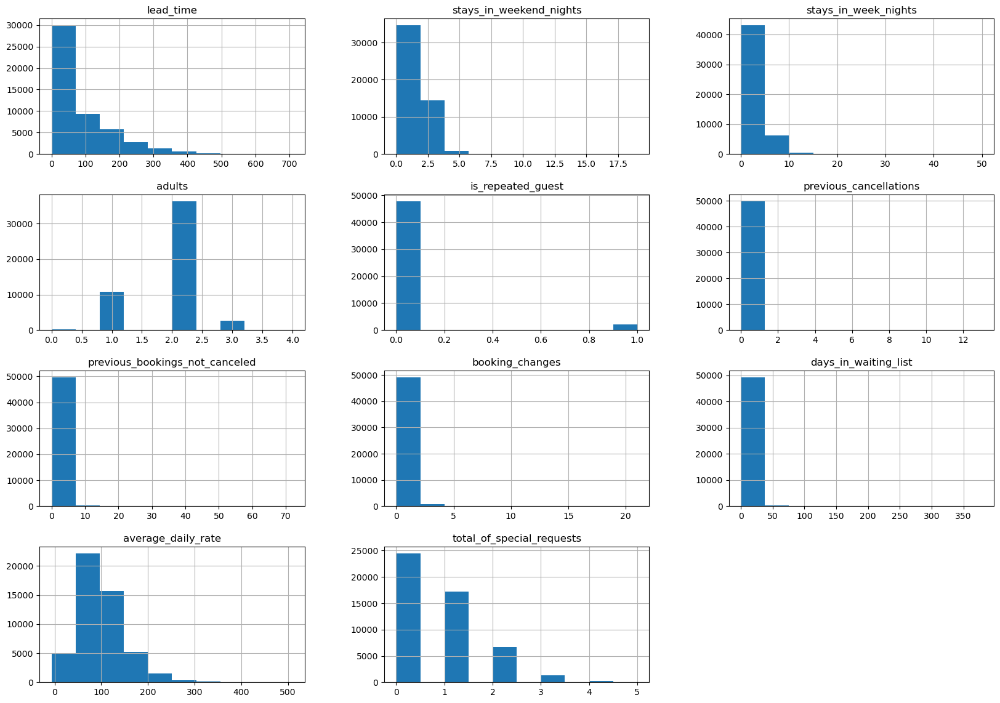

In [54]:
#Histogram for Dataset
df.hist(figsize=(20,14))
plt.show()

In [55]:
#Describe Dataset (AVG - STD - MAX - MIN)
df.describe()
#AVG nums Stays in Weekend
#AVG nums stays in Week


,lead_time,stays_in_weekend_nights,stays_in_week_nights,adults,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,booking_changes,days_in_waiting_list,average_daily_rate,total_of_special_requests
count,50000.000000,50000.000000,50000.000000,50000.000000,50000.000000,50000.000000,50000.000000,50000.000000,50000.0000,50000.000000,50000.000000
mean,80.094120,0.928520,2.464540,1.830280,0.043200,0.016740,0.202740,0.294960,1.5704,99.942342,0.712660
std,91.201362,0.996288,1.936176,0.509078,0.203309,0.287857,1.803691,0.740006,14.7903,49.039092,0.833804
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0000,-6.380000,0.000000
25%,8.000000,0.000000,1.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.0000,67.500000,0.000000
50%,45.000000,1.000000,2.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.0000,92.500000,1.000000
75%,125.000000,2.000000,3.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.0000,125.000000,1.000000
max,709.000000,19.000000,50.000000,4.000000,1.000000,13.000000,72.000000,21.000000,379.0000,510.000000,5.000000


<span style="font-size:20px; font-weight:bold;">Null and Missing Data
</span>


In [56]:
#Did we lost data 
count_null=df.isnull().sum()
for i in range(df.shape[0]-2):
    if(count_null[i]>0):
        print('We have at least one missing data.')
        break
    
null_max=df.isnull().sum().idxmax()
print('The column with the most amount of null is the column** ',null_max,' ***')

null_counts = df.isnull().sum()
print("Missing values per column:\n", null_counts)

We have at least one missing data.
The column with the most amount of null is the column**  country  ***
Missing values per column:
 hotel                               0
lead_time                           0
stays_in_weekend_nights             0
stays_in_week_nights                0
adults                              0
children                            0
meal                                0
country                           289
market_segment                      0
distribution_channel                0
is_repeated_guest                   0
previous_cancellations              0
previous_bookings_not_canceled      0
reserved_room_type                  0
assigned_room_type                  0
booking_changes                     0
deposit_type                        0
days_in_waiting_list                0
customer_type                       0
average_daily_rate                  0
required_car_parking_spaces         0
total_of_special_requests           0
arrival_date                   

<span style="font-size:20px; font-weight:bold;">Outliers Detection
</span>


Outliers detected in lead_time:
              hotel  lead_time  stays_in_weekend_nights  stays_in_week_nights  \
15       City_Hotel        423                        1                     1   
55       City_Hotel        504                        2                     1   
58     Resort_Hotel        386                        1                     3   
103      City_Hotel        457                        0                     2   
216      City_Hotel        405                        0                     2   
237      City_Hotel        504                        2                     1   
246    Resort_Hotel        339                        2                     5   
356      City_Hotel        457                        0                     2   
366    Resort_Hotel        344                        3                     8   
418    Resort_Hotel        307                        2                     4   
433      City_Hotel        429                        0                     2

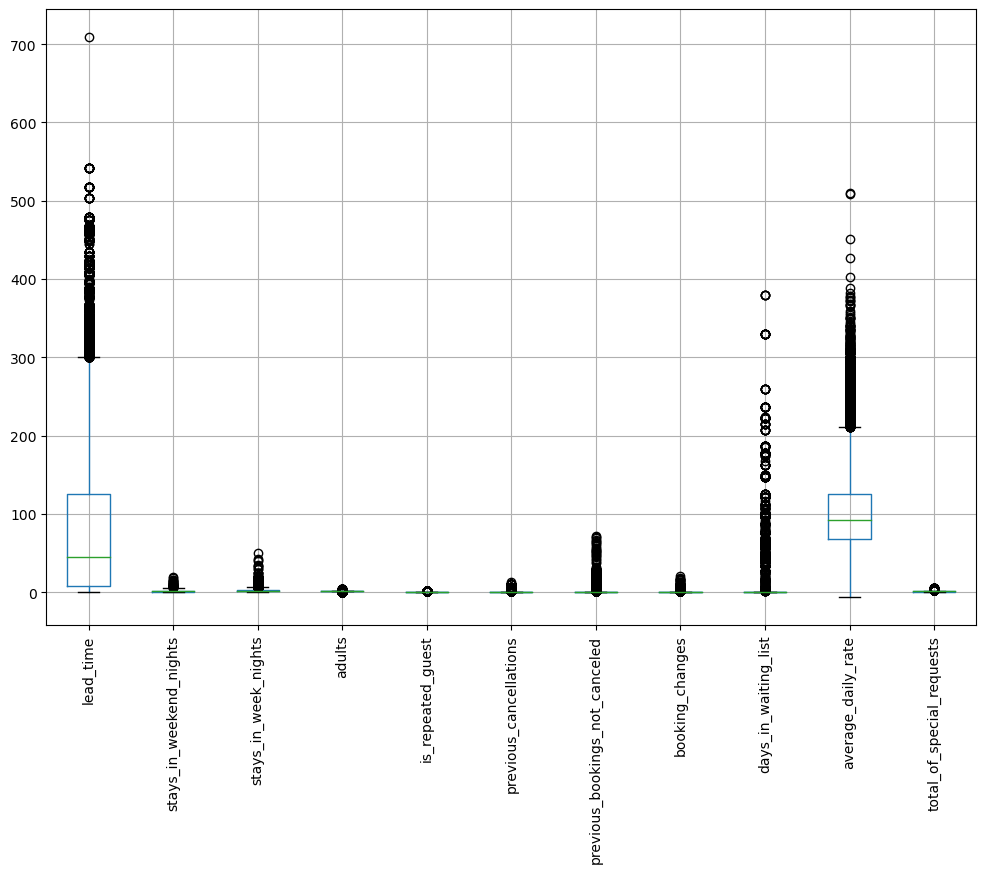

In [57]:
#OUTLIER HANDLING
#Func for Outlier
def detect_outliers_iqr(df, column):
    Q1 = df[column].quantile(0.25)
    Q3 = df[column].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    outliers = df[(df[column] < lower_bound) | (df[column] > upper_bound)]
    return outliers


for col in numeric_cols:
    outliers = detect_outliers_iqr(df, col)
    print(f"Outliers detected in {col}:")
    print(outliers)
    print()

# Boxplot
df[numeric_cols].boxplot(figsize=(12, 8))
plt.xticks(rotation=90)
plt.show()

<span style="font-size:20px; font-weight:bold;">Variable Analysis
</span>


In [58]:
#Country Origin
count_country = df.groupby(by='country').size()
# Sort values in descending order
count_country = count_country.sort_values(ascending=False)
df_count_country = pd.DataFrame(count_country, columns=['count'])


print("The most travelers come from:\n", df_count_country[:1])
print("\nList the 5 countries with the most passengers.\n", df_count_country[:5])
#Note PRT = Portugal 
#Note : The country of origin may influence booking patterns, including the likelihood of traveling with children.

The most travelers come from:
          count
country       
PRT      14046

List the 5 countries with the most passengers.
          count
country       
PRT      14046
GBR       6405
FRA       5627
ESP       4298
DEU       4047


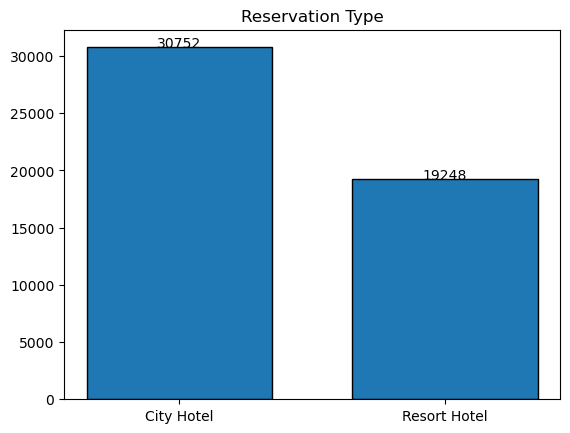

In [59]:
#Hotel Type
value_counts = df['hotel'].value_counts()
values = list(value_counts.values)  

for i in range(len(value_counts.index)):
    plt.text(i, values[i] + 1, str(values[i]), ha='center')
    
plt.title('Reservation Type')
plt.bar(['City Hotel','Resort Hotel'],df['hotel'].value_counts(), edgecolor = 'k',width = 0.7)
plt.show()
#Note Different types of hotels might have different customer demographics.

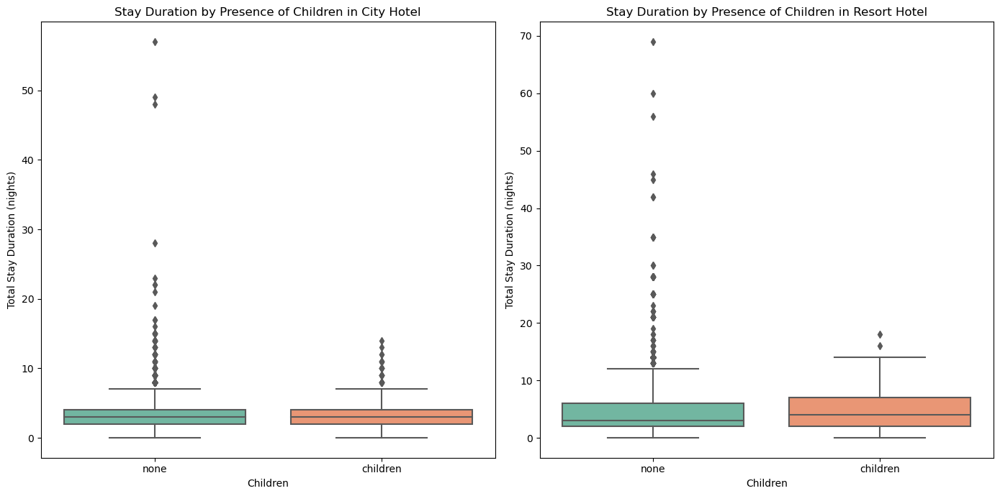

In [60]:
#STAY DURATION
df['total_stay_duration'] = df['stays_in_weekend_nights'] + df['stays_in_week_nights']

plt.figure(figsize=(14, 7))

# City Hotel
plt.subplot(1, 2, 1)
sns.boxplot(x='children', y='total_stay_duration', data=df[df['hotel'] == 'City_Hotel'], palette='Set2')
plt.title('Stay Duration by Presence of Children in City Hotel')
plt.xlabel('Children')
plt.ylabel('Total Stay Duration (nights)')

# Resort Hotel
plt.subplot(1, 2, 2)
sns.boxplot(x='children', y='total_stay_duration', data=df[df['hotel'] == 'Resort_Hotel'], palette='Set2')
plt.title('Stay Duration by Presence of Children in Resort Hotel')
plt.xlabel('Children')
plt.ylabel('Total Stay Duration (nights)')

plt.tight_layout()
plt.show()

#Note :Longer stays might correlate with family trips.
# compare the distribution and spread of stay durations between City and Resort Hotels.

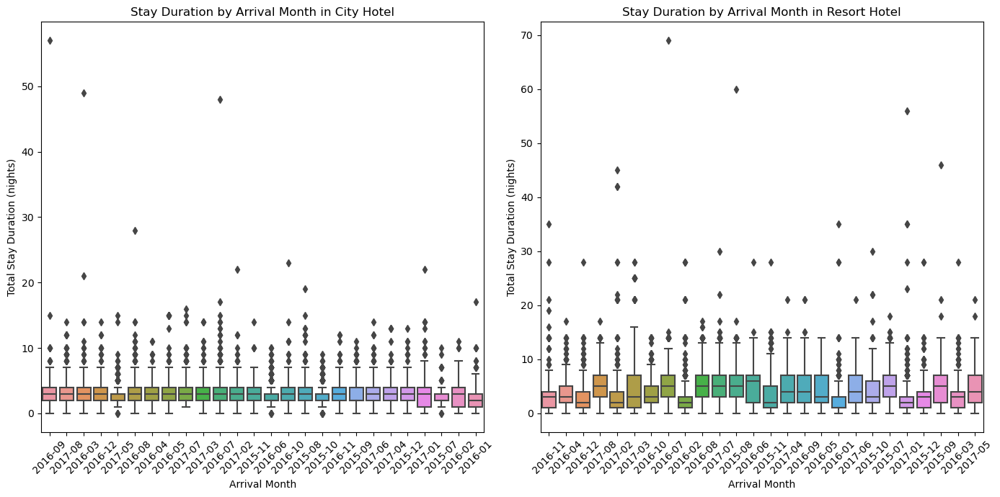

In [61]:
#STAY DURATION #2

df['arrival_date'] = pd.to_datetime(df['arrival_date'])
df['arrival_month'] = df['arrival_date'].dt.to_period('M')

plt.figure(figsize=(14, 7))

# City Hotel
plt.subplot(1, 2, 1)
sns.boxplot(x='arrival_month', y='total_stay_duration', data=df[df['hotel'] == 'City_Hotel'])
plt.title('Stay Duration by Arrival Month in City Hotel')
plt.xlabel('Arrival Month')
plt.ylabel('Total Stay Duration (nights)')
plt.xticks(rotation=45)

# Resort Hotel
plt.subplot(1, 2, 2)
sns.boxplot(x='arrival_month', y='total_stay_duration', data=df[df['hotel'] == 'Resort_Hotel'])
plt.title('Stay Duration by Arrival Month in Resort Hotel')
plt.xlabel('Arrival Month')
plt.ylabel('Total Stay Duration (nights)')
plt.xticks(rotation=45)

plt.tight_layout()
plt.show()

#Note: To observe if there are any temporal trends in stay durations.



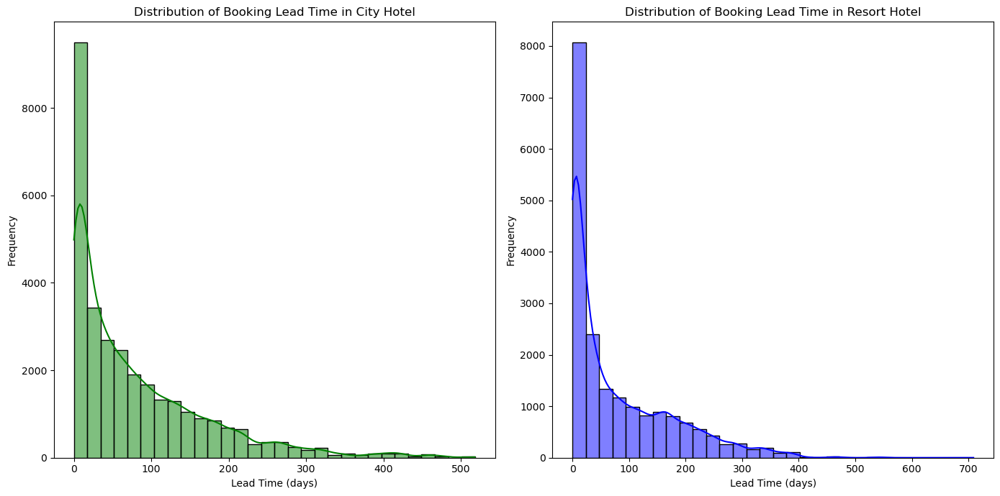

In [62]:
#LEAD TIME
plt.figure(figsize=(14, 7))

# Plot for City Hotel
plt.subplot(1, 2, 1)
sns.histplot(df[df['hotel'] == 'City_Hotel']['lead_time'], bins=30, kde=True, color='green')
plt.title('Distribution of Booking Lead Time in City Hotel')
plt.xlabel('Lead Time (days)')
plt.ylabel('Frequency')

# Plot for Resort Hotel
plt.subplot(1, 2, 2)
sns.histplot(df[df['hotel'] == 'Resort_Hotel']['lead_time'], bins=30, kde=True, color='blue')
plt.title('Distribution of Booking Lead Time in Resort Hotel')

plt.xlabel('Lead Time (days)')
plt.ylabel('Frequency')

plt.tight_layout()
plt.show()

#Note : The lead time might influence the decision to include children, with certain lead times possibly correlating with family trips.

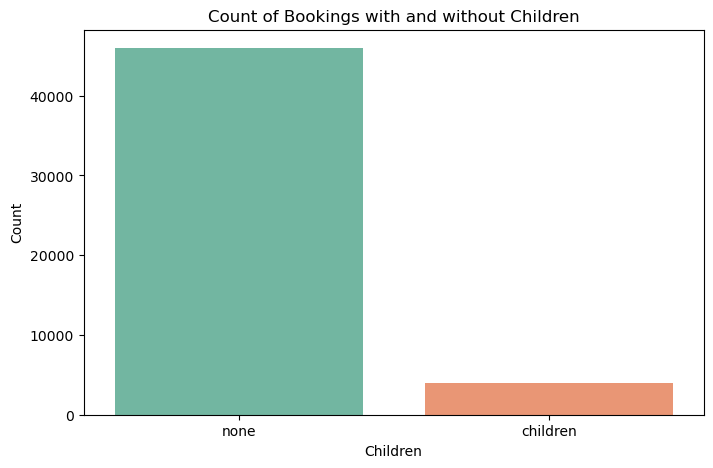

In [63]:
#Number of adults 
plt.figure(figsize=(8, 5))
sns.countplot(x='children', data=df, palette='Set2')
plt.title('Count of Bookings with and without Children')
plt.xlabel('Children')
plt.ylabel('Count')
plt.show()
 #Note : The number of adults can be indicative of family bookings.

Text(0.5, 1.0, 'Number of reservations made')

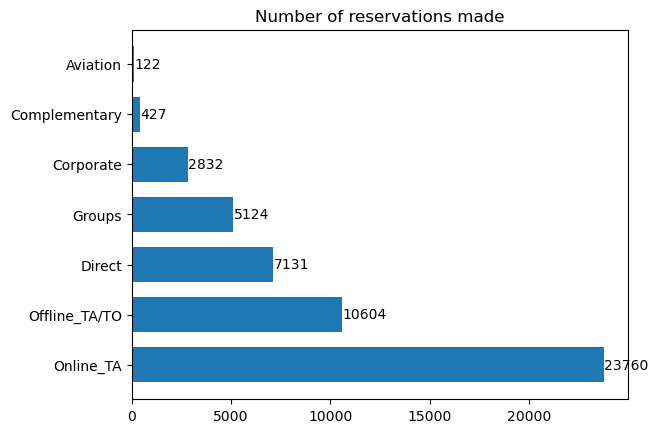

In [64]:
#Market Segment
market_df = df['market_segment'].value_counts().reset_index()
market_df.columns = ['Market', 'Count']

plt.barh(market_df['Market'],market_df['Count'], height=0.7)

for i in range(len(market_df)):
    plt.text(market_df['Count'][i] + 0.5, i, str(market_df['Count'][i]), va='center')
plt.title('Number of reservations made')

#Note: Different market segments (e.g., corporate vs. leisure) might have different booking patterns.

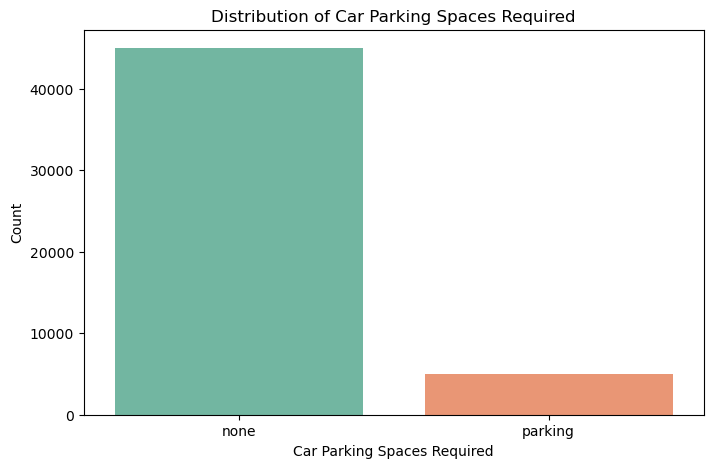

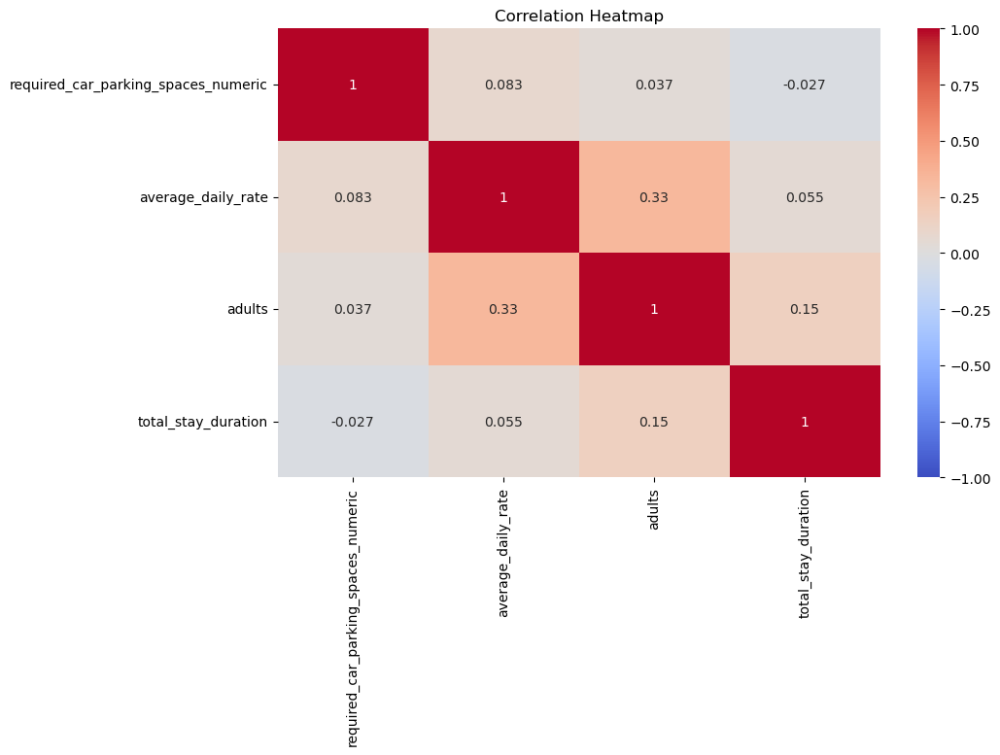

In [65]:
#Car Parking
plt.figure(figsize=(8, 5))
sns.countplot(x='required_car_parking_spaces', data=df, palette='Set2')
plt.title('Distribution of Car Parking Spaces Required')
plt.xlabel('Car Parking Spaces Required')
plt.ylabel('Count')
plt.show()

df['required_car_parking_spaces_numeric'] = df['required_car_parking_spaces'].apply(lambda x: 1 if x == 'parking' else 0)

correlation = df[['required_car_parking_spaces_numeric', 'average_daily_rate', 'adults', 'total_stay_duration']].corr()
plt.figure(figsize=(10, 6))
sns.heatmap(correlation, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Correlation Heatmap')
plt.show()
#Families might require car parking spaces more frequently.

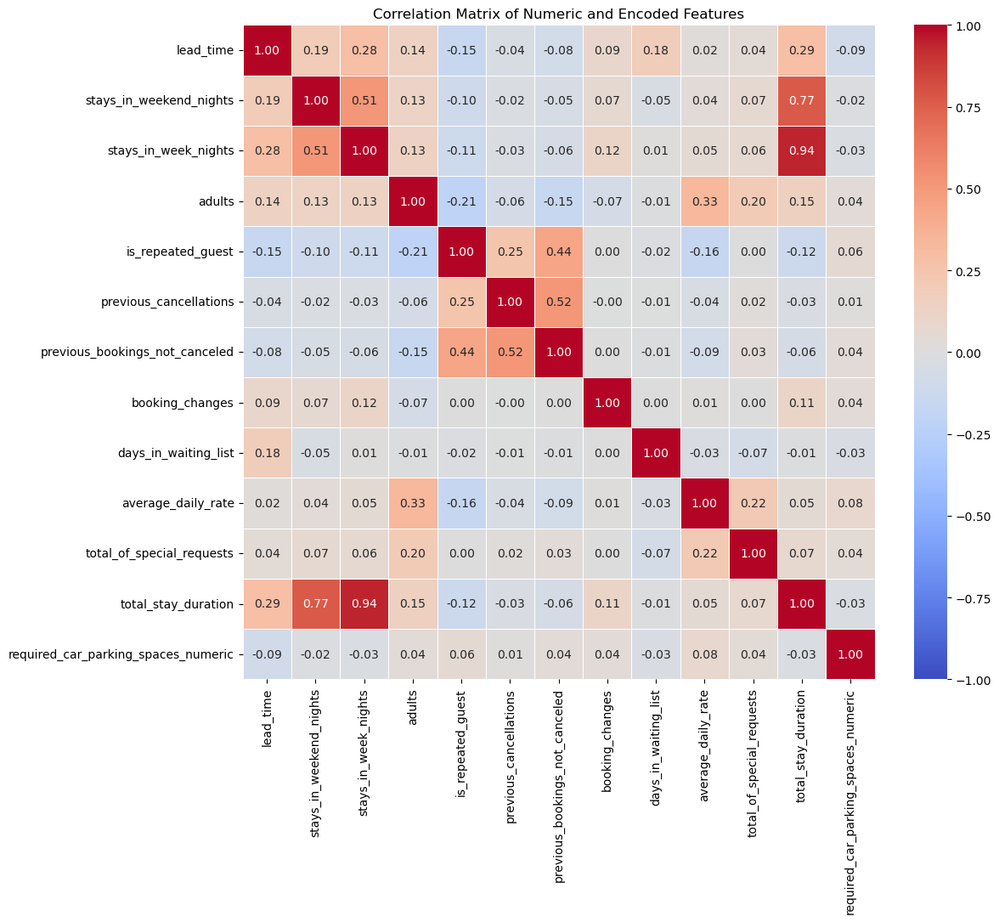

In [66]:
#CORRELATION MATRIX
numeric_columns = df.select_dtypes(include=['number']).columns
df_numeric = df[numeric_columns]

correlation_matrix = df_numeric.corr()
plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', vmin=-1, vmax=1, fmt='.2f', linewidths=0.5)
plt.title('Correlation Matrix of Numeric and Encoded Features')
plt.show()

<span style="font-size:20px; font-weight:bold;">Note for future Variable Analysis</span>


In [67]:
#Notes for future analysis for other variables
# Meal Type -->Rationale: Different meal types may attract different customer demographics.
# Previous Cancellations -->  A high number of previous cancellations might indicate a less reliable booking pattern, possibly affecting family bookings.
#Booking Changes --> Frequent changes might be indicative of uncertain bookings, which could be relevant for predicting family stays.
#Deposit Type --> Deposit policies might affect booking behaviors, including family bookings.
# Distribution Channel --> The distribution channel might be associated with different booking types and guest profiles.
#Total of Special Requests --> A higher number of special requests might be associated with more complex booking requirements, possibly indicating family stays.

<span style="font-size:20px; font-weight:bold;">Encoding</span>


In [68]:
#BINARY ENCODING
#children encoding
df['children'] = df['children'].str.lower()
# Convert the column into 1s and 0s
df['children_encoded'] = df['children'].apply(lambda x: 1 if x == 'children' else 0)

#parking encoding
df['required_car_parking_spaces'] = df['required_car_parking_spaces'].str.lower()
# Convert the column into 1s and 0s
df['required_car_parking_spaces_encoded'] = df['required_car_parking_spaces'].apply(lambda x: 1 if x == 'parking' else 0)


children
none        45962
children     4038
Name: count, dtype: int64 required_car_parking_spaces
none       45019
parking     4981
Name: count, dtype: int64


In [69]:
#Fill Country Null's
hotels['country'].fillna('Unknown', inplace=True)

In [70]:
# Initialize label encoder
label_encoder = LabelEncoder()

# Apply label encoding on both columns
df['hotel_encoded'] = label_encoder.fit_transform(df['hotel'])
df['meal_encoded'] = label_encoder.fit_transform(df['meal'])
df['country_encoded'] = label_encoder.fit_transform(df['country'])
df['market_segment_encoded'] = label_encoder.fit_transform(df['market_segment'])
df['distribution_channel_encoded'] = label_encoder.fit_transform(df['distribution_channel'])
df['reserved_room_type_encoded'] = label_encoder.fit_transform(df['reserved_room_type'])
df['assigned_room_type_encoded'] = label_encoder.fit_transform(df['assigned_room_type'])
df['customer_type_encoded'] = label_encoder.fit_transform(df['customer_type'])
df['deposit_type_encoded'] = label_encoder.fit_transform(df['deposit_type'])

# Show the resulting DataFrame
print(df[['hotel_encoded', 'hotel', 
          'meal_encoded', 'meal',
          'country_encoded','country',
          'market_segment_encoded','market_segment',
          'distribution_channel_encoded','distribution_channel',
          'reserved_room_type_encoded','reserved_room_type',
          'assigned_room_type_encoded','assigned_room_type',
          'customer_type_encoded','customer_type','deposit_type']].head())

   hotel_encoded         hotel  meal_encoded meal  country_encoded country  \
0              0    City_Hotel             0   BB               39     DEU   
1              0    City_Hotel             0   BB              118     PRT   
2              1  Resort_Hotel             0   BB               53     GBR   
3              1  Resort_Hotel             2   HB              122     ROU   
4              1  Resort_Hotel             2   HB              118     PRT   

   market_segment_encoded market_segment  distribution_channel_encoded  \
0                       5  Offline_TA/TO                             3   
1                       3         Direct                             1   
2                       6      Online_TA                             3   
3                       6      Online_TA                             3   
4                       3         Direct                             1   

  distribution_channel  reserved_room_type_encoded reserved_room_type  \
0            

## Part II - Modeling

We will build the best model to predict which actual hotel stays included children/babies, and which did not:

<span style="font-size:20px; font-weight:bold;">New Variable Creation
</span>


In [71]:
df['arrival_date'] = pd.to_datetime(df['arrival_date'])
df['arrival_month'] = df['arrival_date'].dt.month
df['arrival_day_of_week'] = df['arrival_date'].dt.dayofweek
df.columns

Index(['hotel', 'lead_time', 'stays_in_weekend_nights', 'stays_in_week_nights',
       'adults', 'children', 'meal', 'country', 'market_segment',
       'distribution_channel', 'is_repeated_guest', 'previous_cancellations',
       'previous_bookings_not_canceled', 'reserved_room_type',
       'assigned_room_type', 'booking_changes', 'deposit_type',
       'days_in_waiting_list', 'customer_type', 'average_daily_rate',
       'required_car_parking_spaces', 'total_of_special_requests',
       'arrival_date', 'total_stay_duration', 'arrival_month',
       'required_car_parking_spaces_numeric', 'children_encoded',
       'required_car_parking_spaces_encoded', 'hotel_encoded', 'meal_encoded',
       'country_encoded', 'market_segment_encoded',
       'distribution_channel_encoded', 'reserved_room_type_encoded',
       'assigned_room_type_encoded', 'customer_type_encoded',
       'deposit_type_encoded', 'arrival_day_of_week'],
      dtype='object')

In [72]:
#Creation New Variables
df['cost_per_night'] = df['average_daily_rate'] / (df['total_stay_duration'] + 1)
df['total_reservation_cost'] = df['average_daily_rate'] * df['total_stay_duration']
df['previous_bookings_status'] = df['previous_cancellations'] + df['previous_bookings_not_canceled']


<span style="font-size:20px; font-weight:bold;">Splitting the Dataset
</span>


In [91]:

#Test and Train
X = df.drop(columns=['children','children_encoded', 'arrival_date','hotel', 'meal', 'country',
       'market_segment', 'distribution_channel',
       'reserved_room_type', 'assigned_room_type','deposit_type','required_car_parking_spaces',
       'customer_type'])
y = df['children_encoded']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

X_train.columns
X_train.head(1)

,lead_time,stays_in_weekend_nights,stays_in_week_nights,adults,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,booking_changes,days_in_waiting_list,average_daily_rate,total_of_special_requests,total_stay_duration,arrival_month,required_car_parking_spaces_numeric,required_car_parking_spaces_encoded,hotel_encoded,meal_encoded,country_encoded,market_segment_encoded,distribution_channel_encoded,reserved_room_type_encoded,assigned_room_type_encoded,customer_type_encoded,deposit_type_encoded,arrival_day_of_week,cost_per_night,total_reservation_cost,previous_bookings_status
39087,110,1,0,1,0,0,0,1,0,120.0,0,1,10,0,0,0,0,10,5,3,0,9,3,0,6,60.0,120.0,0


<span style="font-size:20px; font-weight:bold;">Normalization/Standardization</span>


In [74]:
# Standardize features (important for SVR)
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

<span style="font-size:20px; font-weight:bold;">Models
</span>


In [103]:
# Initialize models
models = {
    'Logistic Regression': LogisticRegression(max_iter=500, random_state=42),
    'Support Vector Machine': SVC(),
    'Random Forest': RandomForestClassifier(random_state=42),
    'Decision Tree': DecisionTreeClassifier(random_state=42),
    'K-Nearest Neighbors': KNeighborsClassifier(),
    'Gradient Boosting': GradientBoostingClassifier(random_state=42),
    'Neural Network': MLPClassifier(hidden_layer_sizes=(100,), max_iter=500, random_state=42)
}

# Dictionary to hold results
results = {}

# Train and evaluate models
for name, model in models.items():
    try:
        # Train the model
        model.fit(X_train, y_train)
        
        # Save the model to a file
        model_filename = f'Fligo/Fligo/models/{name.replace(" ", "_")}.joblib'
        joblib.dump(model, model_filename)
        print(f'{name} model saved to {model_filename}')
        
        # Predict on the test set
        y_pred = model.predict(X_test)
        
        # Calculate metrics
        report = classification_report(y_test, y_pred, output_dict=True)
        cm = confusion_matrix(y_test, y_pred)
        
        # Store results
        results[name] = {
            'Classification Report': report,
            'Confusion Matrix': cm
        }
        
    except Exception as e:
        # Handle errors
        results[name] = {'Error': str(e)}

# Print results
for name, metrics in results.items():
    if 'Error' in metrics:
        print(f'{name} - Error: {metrics["Error"]}')
    else:
        print(f'{name} - Classification Report:')
        print(pd.DataFrame(metrics['Classification Report']).transpose())
        print('Confusion Matrix:')
        print(metrics['Confusion Matrix'])
        print()


/Users/ignaciopaniagualantelli/anaconda3/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Logistic Regression model saved to Fligo/Fligo/models/Logistic_Regression.joblib
Support Vector Machine model saved to Fligo/Fligo/models/Support_Vector_Machine.joblib


/Users/ignaciopaniagualantelli/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ignaciopaniagualantelli/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/Users/ignaciopaniagualantelli/anaconda3/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier

Random Forest model saved to Fligo/Fligo/models/Random_Forest.joblib
Decision Tree model saved to Fligo/Fligo/models/Decision_Tree.joblib
K-Nearest Neighbors model saved to Fligo/Fligo/models/K-Nearest_Neighbors.joblib
Gradient Boosting model saved to Fligo/Fligo/models/Gradient_Boosting.joblib
Neural Network model saved to Fligo/Fligo/models/Neural_Network.joblib
Logistic Regression - Classification Report:
              precision    recall  f1-score     support
0              0.929753  0.991399  0.959587   9185.0000
1              0.616505  0.155828  0.248776    815.0000
accuracy       0.923300  0.923300  0.923300      0.9233
macro avg      0.773129  0.573614  0.604181  10000.0000
weighted avg   0.904223  0.923300  0.901656  10000.0000
Confusion Matrix:
[[9106   79]
 [ 688  127]]

Support Vector Machine - Classification Report:
              precision  recall  f1-score     support
0              0.918500  1.0000  0.957519   9185.0000
1              0.000000  0.0000  0.000000    815.0

<span style="font-size:20px; font-weight:bold;">Models Comparison
</span>


In [89]:

metrics_df = pd.DataFrame(columns=['Model', 'Accuracy', 'Precision (0)', 'Recall (0)', 'F1-Score (0)', 'Precision (1)', 'Recall (1)', 'F1-Score (1)'])

for name, metrics in results.items():
    if 'Error' in metrics:
        print(f'{name} - Error: {metrics["Error"]}')
    else:
        report = metrics['Classification Report']
        accuracy = metrics['Classification Report']['accuracy']
        precision_0 = report['0']['precision']
        recall_0 = report['0']['recall']
        f1_score_0 = report['0']['f1-score']
        precision_1 = report['1']['precision']
        recall_1 = report['1']['recall']
        f1_score_1 = report['1']['f1-score']
        

        temp_df = pd.DataFrame([{
            'Model': name,
            'Accuracy': accuracy,
            'Precision (0)': precision_0,
            'Recall (0)': recall_0,
            'F1-Score (0)': f1_score_0,
            'Precision (1)': precision_1,
            'Recall (1)': recall_1,
            'F1-Score (1)': f1_score_1
        }])
        
        metrics_df = pd.concat([metrics_df, temp_df], ignore_index=True)


print(metrics_df)

# Best Model on each metric
best_accuracy = metrics_df.loc[metrics_df['Accuracy'].idxmax()]
best_precision_0 = metrics_df.loc[metrics_df['Precision (0)'].idxmax()]
best_recall_0 = metrics_df.loc[metrics_df['Recall (0)'].idxmax()]
best_f1_score_0 = metrics_df.loc[metrics_df['F1-Score (0)'].idxmax()]
best_precision_1 = metrics_df.loc[metrics_df['Precision (1)'].idxmax()]
best_recall_1 = metrics_df.loc[metrics_df['Recall (1)'].idxmax()]
best_f1_score_1 = metrics_df.loc[metrics_df['F1-Score (1)'].idxmax()]

# Get the best model overall (based on Accuracy)
best_overall = best_accuracy

print("\nBest Model for Accuracy:")
print(best_accuracy)

print("\nBest Model for Precision in Class 0:")
print(best_precision_0)

print("\nBest Model for Recall in Class 0:")
print(best_recall_0)

print("\nBest Model for F1-Score in Class 0:")
print(best_f1_score_0)

print("\nBest Model for Precision in Class 1:")
print(best_precision_1)

print("\nBest Model for Recall in Class 1:")
print(best_recall_1)

print("\nBest Model for F1-Score in Class 1:")
print(best_f1_score_1)

print("\nBest Overall Model (based on Accuracy):")
print(best_overall)

                    Model  Accuracy  Precision (0)  Recall (0)  F1-Score (0)  \
0     Logistic Regression    0.9232       0.929570    0.991508      0.959541   
1  Support Vector Machine    0.9367       0.940099    0.994447      0.966510   
2           Random Forest    0.9413       0.946603    0.992052      0.968795   
3           Decision Tree    0.9124       0.953697    0.950789      0.952241   
4     K-Nearest Neighbors    0.9310       0.939291    0.988786      0.963403   
5       Gradient Boosting    0.9398       0.946985    0.989875      0.967955   
6          Neural Network    0.9365       0.954111    0.977899      0.965858   

   Precision (1)  Recall (1)  F1-Score (1)  
0       0.615764    0.153374      0.245580  
1       0.820423    0.285890      0.424022  
2       0.804813    0.369325      0.506308  
3       0.463820    0.479755      0.471653  
4       0.688822    0.279755      0.397906  
5       0.766917    0.375460      0.504119  
6       0.653584    0.469939      0.546752  

<span style="font-size:20px; font-weight:bold;">Feature Importance</span>


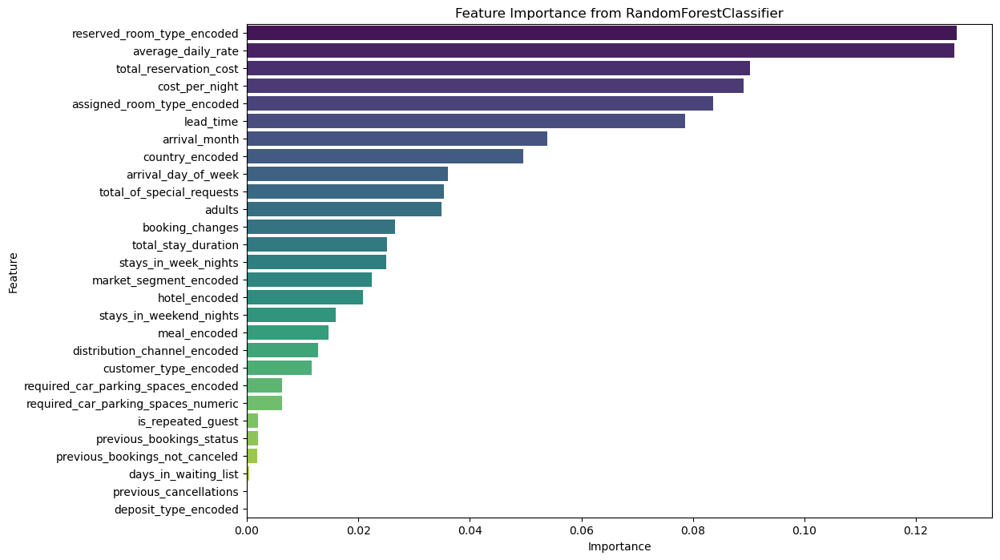

In [93]:

rfmodel = RandomForestClassifier(random_state=42)
rfmodel.fit(X_train, y_train)

# Compute feature importance
importances = rfmodel.feature_importances_

# Create a DataFrame for better visualization
feature_names = X_train.columns  # Assuming X_train is a DataFrame
importance_df = pd.DataFrame({
    'Feature': feature_names,
    'Importance': importances
})

# Sort features by importance
importance_df = importance_df.sort_values(by='Importance', ascending=False)

# Plot feature importance
plt.figure(figsize=(12, 8))
sns.barplot(x='Importance', y='Feature', data=importance_df, palette='viridis')
plt.title('Feature Importance from RandomForestClassifier')
plt.xlabel('Importance')
plt.ylabel('Feature')
plt.show()

<span style="font-size:20px; font-weight:bold;">Shap
</span>


/Users/ignaciopaniagualantelli/anaconda3/lib/python3.11/site-packages/shap/plots/_beeswarm.py:950: UserWarning: The figure layout has changed to tight
  pl.tight_layout()
/Users/ignaciopaniagualantelli/anaconda3/lib/python3.11/site-packages/shap/plots/_beeswarm.py:624: UserWarning: The figure layout has changed to tight
  pl.tight_layout(pad=0, w_pad=0, h_pad=0.0)


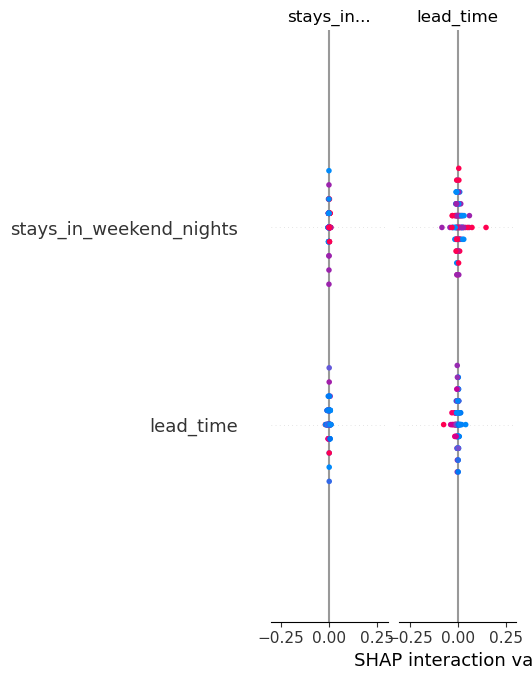

In [47]:
#SHAP (takes time)
sample_size = 100 # Adjust 
X_test_subset = X_test.sample(n=sample_size, random_state=42)

# Compute SHAP values for the subset
explainer = shap.TreeExplainer(rfmodel)
shap_values = explainer.shap_values(X_test_subset)

# Plot feature importance summary for the subset
shap.summary_plot(shap_values, X_test_subset, plot_type="bar")

<span style="font-size:20px; font-weight:bold;">Hyperparameter Tuning</span>


In [ ]:
#Takes time
param_dist = {
    'n_estimators': randint(100, 500),
    'max_features': ['auto', 'sqrt', 'log2'],
    'max_depth': [None, 10, 20, 30],
    'min_samples_split': randint(2, 20),
    'min_samples_leaf': randint(1, 20),
    'bootstrap': [True, False]
}


rfmodel = RandomForestClassifier(random_state=42)

# RandomizedSearchCV
random_search = RandomizedSearchCV(estimator=rfmodel,
                                    param_distributions=param_dist,
                                    n_iter=40,         # Number of parameter settings to sample
                                    cv=5,               # Number of folds in cross-validation
                                    n_jobs=-1,          # Use all available cores
                                    verbose=2,          # Print progress
                                    random_state=42)    # Ensure reproducibility

# Fit 
random_search.fit(X_train, y_train)

# Best parameters and best score
print("Best parameters found: ", random_search.best_params_)
print("Best score found: ", random_search.best_score_)

# Best model
best_rfmodel = random_search.best_estimator_

# Use the best model for predictions
y_pred = best_rfmodel.predict(X_test)

<span style="font-size:20px; font-weight:bold;">Cross-Validation/span>


In [97]:

# Use the rfmodel 

# Set up k-fold cross-validation
k = 5  # Number of folds
kf = KFold(n_splits=k, shuffle=True, random_state=42)

# Cross-validated scores
cv_scores = cross_val_score(rfmodel, X, y, cv=kf, scoring='accuracy')

# Result
print(f"Cross-Validation Scores: {cv_scores}")
print(f"Mean CV Accuracy: {np.mean(cv_scores):.4f}")
print(f"Standard Deviation of CV Accuracy: {np.std(cv_scores):.4f}")

Cross-Validation Scores: [0.9412 0.9451 0.9419 0.9465 0.9461]
Mean CV Accuracy: 0.9442
Standard Deviation of CV Accuracy: 0.0022


In [ ]:
#The model shows high accuracy with an average of about 94.42% across cross-validation folds, and its performance is quite consistent with very little variation.

## Part III - Results & Conclusions

I understand that this part will be done verbally with an interviewer, so I am leaving it blank for a future interview.